Created on October 1 2020

@author: Param Shah

In [ ]:
import tensorflow as tf
import os
import time
from matplotlib import pyplot as plt
from IPython import display
from glob import glob
from tensorflow.keras.layers import UpSampling2D, Conv2D

In [ ]:
gpus = tf.config.experimental.list_logical_devices('GPU')
gpus

[LogicalDevice(name='/device:GPU:0', device_type='GPU')]

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ls '/content/drive/My Drive/maps.tar.gz'

'/content/drive/My Drive/maps.tar.gz'


In [ ]:
!tar xf  '/content/drive/My Drive/maps.tar.gz'

In [ ]:
PATH = os.listdir("maps/")
PATH

['val', 'train']

In [ ]:
BUFFER_SIZE = 400
batch_size = 1
img_W = 256
img_H = 256

**Preprocessing of the images**

In [ ]:
def preprocess(image):
  imag = tf.io.read_file(image)
  image = tf.image.decode_jpeg(imag)

  w = tf.shape(image)[1]

  #splitting the input image and the real image into 2 new images
  w = w // 2
  input_img = image[:, :w, :]
  ground_img = image[:, w:, :]

  input_img = tf.cast(input_img, tf.float32)
  ground_img = tf.cast(ground_img, tf.float32)

  return input_img, ground_img

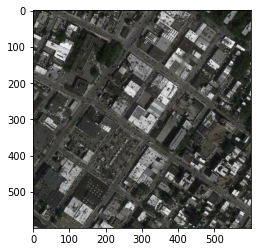

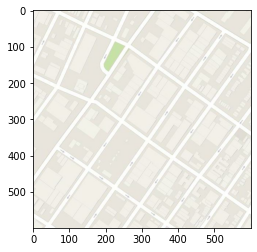

In [ ]:
inp, re = preprocess("./maps/train/10.jpg")
# casting to int for matplotlib to show the image
plt.figure()
plt.imshow(inp/255.0)
plt.figure()
plt.imshow(re/255.0)

In [ ]:
# normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

As you can see in the images below that they are going through random jittering Random jittering as described in the paper is to

1)Resize an image to bigger height and width

2)Randomly crop to the target size

3)Randomly flip the image horizontally

this is a trick to avoid overfitting

In [ ]:

def random_jitter(input_img, ground_img,img_W,img_H):
  #resize the image
  input_img = tf.image.resize(input_img, [286, 286],method=tf.image.ResizeMethod.NEAREST_NEIGHBOR) #Input image
  ground_img = tf.image.resize(ground_img, [286, 286],method=tf.image.ResizeMethod.NEAREST_NEIGHBOR) #Ground Truth image
  
  # randomly cropping to 256 x 256 x 3
  stacked_image = tf.stack([input_img, ground_img], axis=0)
  cropped_image = tf.image.random_crop(stacked_image, size=[2, img_H, img_W, 3])
  input_img, ground_img = cropped_image[0], cropped_image[1]

# If training => do random flip , this is a trick to avoid overfitting
  if tf.random.uniform(()) > 0.5:
    # random mirroring
    input_img = tf.image.flip_left_right(input_img)
    ground_img = tf.image.flip_left_right(ground_img)

  return input_img, ground_img


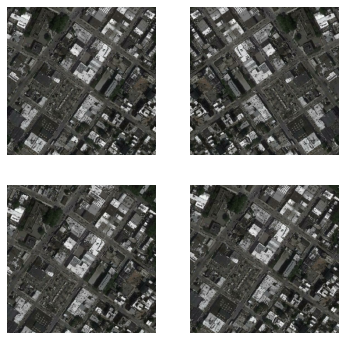

In [ ]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re,img_W,img_H)
  plt.subplot(2, 2, i+1)
  plt.imshow(rj_inp/255.0)
  plt.axis('off')
plt.show()

**loading the training and testing images**

In [ ]:
def train(image):
  input_img, ground_img = preprocess(image)
  input_img, ground_img = random_jitter(input_img, ground_img,img_W,img_H)
  input_img, ground_img = normalize(input_img, ground_img)

  return input_img, ground_img

In [ ]:
def test(image):
  input_img, ground_img = preprocess(image)
  input_img = tf.image.resize(input_img, size=[img_H, img_W],method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  ground_img = tf.image.resize(ground_img, size=[img_H,img_W],method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  input_img, ground_img = normalize(input_img, ground_img)

  return input_img, ground_img

In [ ]:
#calling the training data
train_dataset = tf.data.Dataset.list_files("maps/train/*.jpg")
train_dataset = train_dataset.map(train).shuffle(BUFFER_SIZE).batch(batch_size).cache()
train_dataset = train_dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
#calling the testing data
test_dataset = tf.data.Dataset.list_files("maps/val/*.jpg")
test_dataset = test_dataset.map(test).batch(batch_size)

**Generator**

In [ ]:
channels =3
gf =64

#U-NET Architecture
def conv2d(layer_input, filters, f_size=3, bn=True): #downsampling
    d = tf.keras.layers.Conv2D(filters, kernel_size=f_size, strides=2,use_bias=False, padding='same')(layer_input)
    d = tf.keras.layers.LeakyReLU()(d)
    if bn:
        d = tf.keras.layers.BatchNormalization()(d)
    return d

          #Layers used during upsampling
def deconv2d(layer_input, skip_input, filters, f_size=3, dropout_rate=False): #upsampling
    u = tf.keras.layers.Conv2DTranspose(filters, kernel_size=f_size, strides=2,use_bias=False, padding='same')(layer_input)
    if dropout_rate:
        u = tf.keras.layers.Dropout(0.5)(u)
    u = tf.keras.layers.BatchNormalization()(u)
    u = tf.keras.layers.LeakyReLU()(u)
    u = tf.keras.layers.Concatenate()([u, skip_input]) #skip connection
    return u
def Generator():
    initializer = tf.random_normal_initializer(0., 0.02)
    #Layers used during downsampling

    d0 = tf.keras.layers.Input(shape=[256,256,3])

    # Downsampling
    d1 = conv2d(d0, gf, bn=False)
    d2 = conv2d(d1, gf*2)
    d3 = conv2d(d2, gf*4)
    d4 = conv2d(d3, gf*8)
    d5 = conv2d(d4, gf*8)
    d6 = conv2d(d5, gf*8)
    d7 = conv2d(d6, gf*8)
    d8 = conv2d(d7, gf*8)

    # Upsampling
    u1 = deconv2d(d8, d7, gf*8,dropout_rate=True)
    u2 = deconv2d(u1, d6, gf*8,dropout_rate=True)
    u3 = deconv2d(u2, d5, gf*8,dropout_rate=True)
    u4 = deconv2d(u3, d4, gf*8)
    u5 = deconv2d(u4, d3, gf*4)
    u6 = deconv2d(u5, d2, gf*2)
    u7 = deconv2d(u6, d1, gf)

    output_img = tf.keras.layers.Conv2DTranspose(channels, kernel_size=4, strides=2, padding='same', use_bias=False,activation='tanh')(u7)

    model= tf.keras.Model(d0, output_img)
    if len(gpus)>1:
        return tf.keras.utils.multi_gpu_model(model, gpus=len(gpus), cpu_merge=True, cpu_relocation=False)
    else:
        return model

In [ ]:
generator = Generator()
#tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

**Generator loss**

In [ ]:
Lambda = 100
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(disc_generated_output), disc_generated_output)
  # mean absolute error L1 loss
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (Lambda * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

**Discriminator**

In [ ]:
df=64

#Patch GAN Architecture
def d_layer(layer_input, filters, f_size=4, bn=True):
    d = tf.keras.layers.Conv2D(filters, kernel_size=f_size, strides=2,use_bias=False, padding='same')(layer_input)
    d = tf.keras.layers.LeakyReLU()(d)
    if bn:
        d = tf.keras.layers.BatchNormalization()(d)
    return d
def Discriminator():
        initializer = tf.random_normal_initializer(0., 0.02)
        img_A = tf.keras.layers.Input(shape=[256, 256, 3])
        img_B = tf.keras.layers.Input(shape=[256, 256, 3])

        combined_imgs = tf.keras.layers.Concatenate(axis=-1)([img_A, img_B])

        d1 = d_layer(combined_imgs, df, bn=False)
        d2 = d_layer(d1, df*2)
        d3 = d_layer(d2, df*4)
        zero_pad1 = tf.keras.layers.ZeroPadding2D()(d3)
        conv = tf.keras.layers.Conv2D(512, 4, strides=1,kernel_initializer=initializer,use_bias=False)(zero_pad1) 

        batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

        leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

        zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)

        validity = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) 

        model = tf.keras.Model([img_A, img_B], validity)
        if len(gpus)>1:
            return tf.keras.utils.multi_gpu_model(model, gpus=len(gpus), cpu_merge=True, cpu_relocation=False)
        else:
            return model

In [ ]:
discriminator = Discriminator()
#tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

**Discriminator loss**

In [ ]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)



In [ ]:
def generate_images(model, test_input, tar,epoch,save_or_not =True):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

loss upgradation using sgd

In [ ]:
def train_step(input_image, target, g_loss_metric, d_loss_metric):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  g_loss_metric.update_state(gen_total_loss)
  d_loss_metric.update_state(disc_loss)
  
  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

print("starting training")


starting training


In [ ]:
for i ,(input ,target )in enumerate(test_dataset.take(1)):
  inp =input
  tar =target
  break

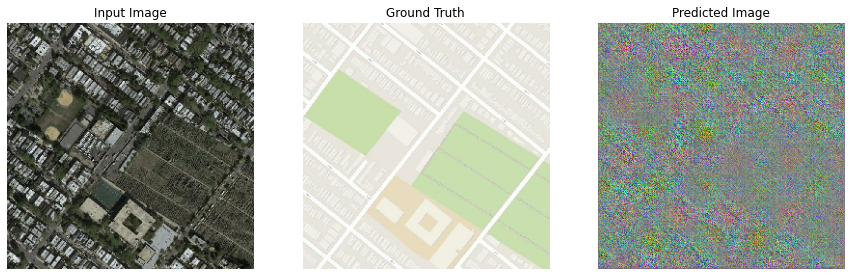

In [ ]:
generate_images(generator, inp, tar,1)

**Running the model for 200 epochs**

Epoch:  0
  loss (g) (d) (g+d):     14.974, 0.985, 15.959


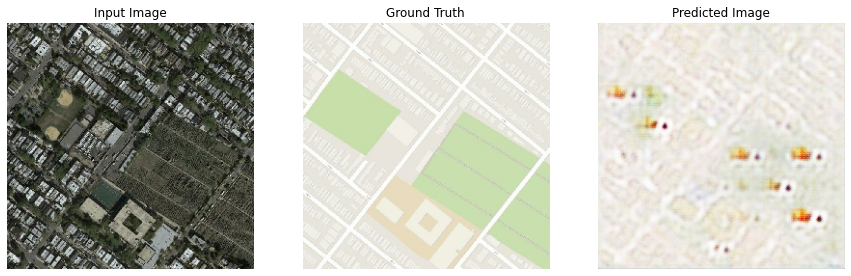

Time taken for epoch 0 is 101.88178873062134 sec

Epoch:  1
  loss (g) (d) (g+d):     13.032, 0.903, 13.935
Time taken for epoch 1 is 89.77441740036011 sec

Epoch:  2
  loss (g) (d) (g+d):     12.753, 0.770, 13.523
Time taken for epoch 2 is 89.4668071269989 sec

Epoch:  3
  loss (g) (d) (g+d):     12.732, 0.669, 13.402
Time taken for epoch 3 is 88.9432942867279 sec

Epoch:  4
  loss (g) (d) (g+d):     12.507, 0.622, 13.129
Time taken for epoch 4 is 89.11868834495544 sec

Epoch:  5
  loss (g) (d) (g+d):     12.352, 0.637, 12.989


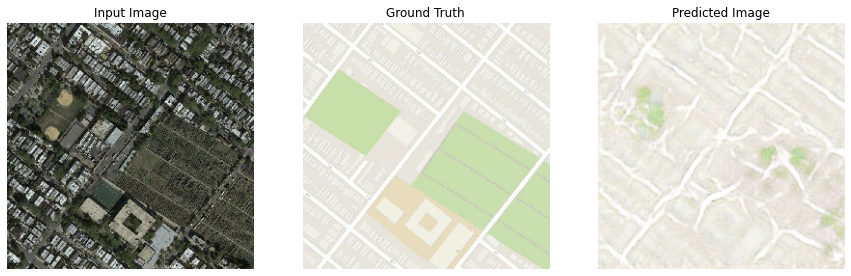

Time taken for epoch 5 is 89.38655757904053 sec

Epoch:  6
  loss (g) (d) (g+d):     12.215, 0.567, 12.782
Time taken for epoch 6 is 89.1260883808136 sec

Epoch:  7
  loss (g) (d) (g+d):     12.316, 0.572, 12.889
Time taken for epoch 7 is 88.97606039047241 sec

Epoch:  8
  loss (g) (d) (g+d):     12.295, 0.511, 12.806
Time taken for epoch 8 is 88.73921155929565 sec

Epoch:  9
  loss (g) (d) (g+d):     12.112, 0.512, 12.624
Time taken for epoch 9 is 88.80008244514465 sec

Epoch:  10
  loss (g) (d) (g+d):     12.129, 0.524, 12.653


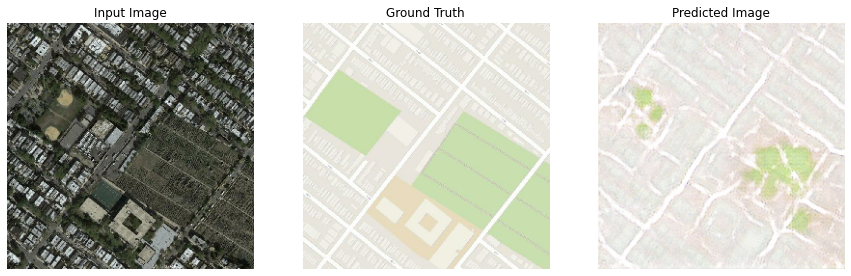

Time taken for epoch 10 is 88.7128176689148 sec

Epoch:  11
  loss (g) (d) (g+d):     12.018, 0.522, 12.539
Time taken for epoch 11 is 88.69195747375488 sec

Epoch:  12
  loss (g) (d) (g+d):     11.944, 0.494, 12.438
Time taken for epoch 12 is 89.21654224395752 sec

Epoch:  13
  loss (g) (d) (g+d):     11.864, 0.500, 12.365
Time taken for epoch 13 is 89.04375147819519 sec

Epoch:  14
  loss (g) (d) (g+d):     11.914, 0.497, 12.411
Time taken for epoch 14 is 89.02348184585571 sec

Epoch:  15
  loss (g) (d) (g+d):     11.833, 0.484, 12.318


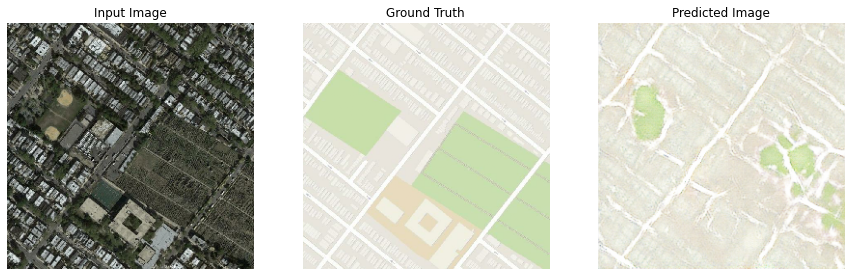

Time taken for epoch 15 is 89.4206235408783 sec

Epoch:  16
  loss (g) (d) (g+d):     11.874, 0.494, 12.368
Time taken for epoch 16 is 89.13174152374268 sec

Epoch:  17
  loss (g) (d) (g+d):     11.615, 0.505, 12.120
Time taken for epoch 17 is 88.68158555030823 sec

Epoch:  18
  loss (g) (d) (g+d):     11.555, 0.471, 12.025
Time taken for epoch 18 is 88.80362558364868 sec

Epoch:  19
  loss (g) (d) (g+d):     11.422, 0.518, 11.940
Time taken for epoch 19 is 90.09694695472717 sec

Epoch:  20
  loss (g) (d) (g+d):     11.460, 0.495, 11.955


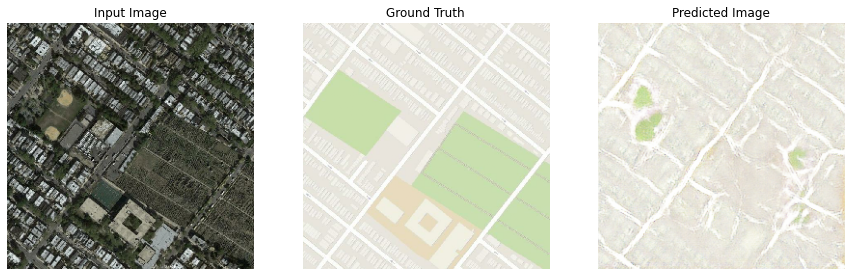

Time taken for epoch 20 is 88.68533992767334 sec

Epoch:  21
  loss (g) (d) (g+d):     11.492, 0.448, 11.940
Time taken for epoch 21 is 88.78596520423889 sec

Epoch:  22
  loss (g) (d) (g+d):     11.331, 0.492, 11.823
Time taken for epoch 22 is 88.31319427490234 sec

Epoch:  23
  loss (g) (d) (g+d):     11.452, 0.483, 11.935
Time taken for epoch 23 is 88.6475977897644 sec

Epoch:  24
  loss (g) (d) (g+d):     11.313, 0.473, 11.786
Time taken for epoch 24 is 88.34193062782288 sec

Epoch:  25
  loss (g) (d) (g+d):     11.200, 0.503, 11.703


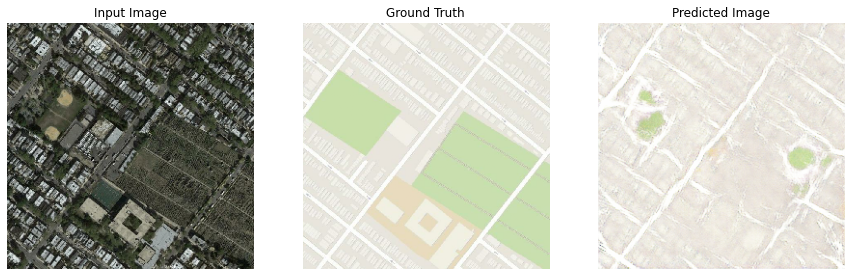

Time taken for epoch 25 is 88.58307313919067 sec

Epoch:  26
  loss (g) (d) (g+d):     11.304, 0.450, 11.753
Time taken for epoch 26 is 88.65262460708618 sec

Epoch:  27
  loss (g) (d) (g+d):     11.139, 0.518, 11.658
Time taken for epoch 27 is 88.41469073295593 sec

Epoch:  28
  loss (g) (d) (g+d):     11.172, 0.446, 11.618
Time taken for epoch 28 is 88.40059566497803 sec

Epoch:  29
  loss (g) (d) (g+d):     11.015, 0.507, 11.522
Time taken for epoch 29 is 88.20794892311096 sec

Epoch:  30
  loss (g) (d) (g+d):     11.158, 0.441, 11.599


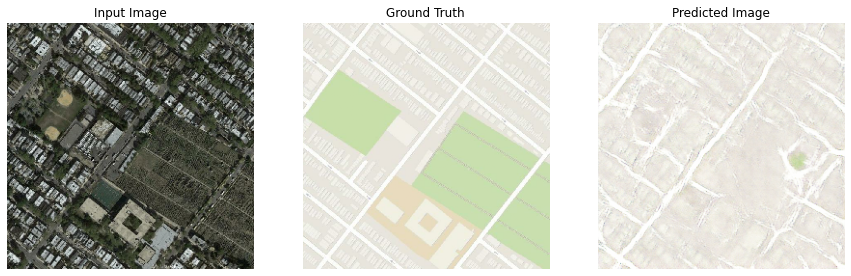

Time taken for epoch 30 is 88.83932900428772 sec

Epoch:  31
  loss (g) (d) (g+d):     10.893, 0.528, 11.422
Time taken for epoch 31 is 88.4438693523407 sec

Epoch:  32
  loss (g) (d) (g+d):     10.872, 0.508, 11.379
Time taken for epoch 32 is 88.40172815322876 sec

Epoch:  33
  loss (g) (d) (g+d):     11.029, 0.420, 11.449
Time taken for epoch 33 is 88.52191257476807 sec

Epoch:  34
  loss (g) (d) (g+d):     10.857, 0.529, 11.386
Time taken for epoch 34 is 88.49369168281555 sec

Epoch:  35
  loss (g) (d) (g+d):     10.860, 0.498, 11.358


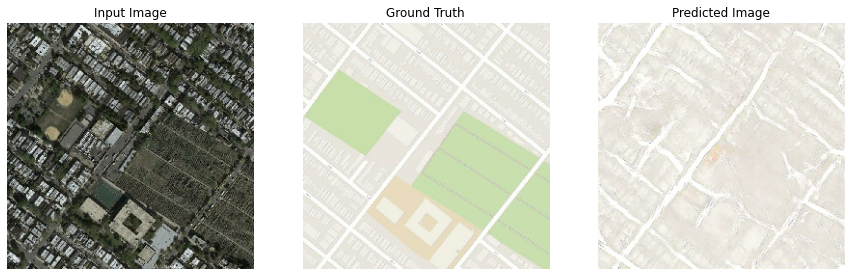

Time taken for epoch 35 is 88.85240483283997 sec

Epoch:  36
  loss (g) (d) (g+d):     10.612, 0.506, 11.118
Time taken for epoch 36 is 88.55777287483215 sec

Epoch:  37
  loss (g) (d) (g+d):     10.824, 0.466, 11.290
Time taken for epoch 37 is 88.57175898551941 sec

Epoch:  38
  loss (g) (d) (g+d):     10.693, 0.512, 11.205
Time taken for epoch 38 is 88.40768122673035 sec

Epoch:  39
  loss (g) (d) (g+d):     10.571, 0.519, 11.090
Time taken for epoch 39 is 89.35198616981506 sec

Epoch:  40
  loss (g) (d) (g+d):     10.733, 0.487, 11.220


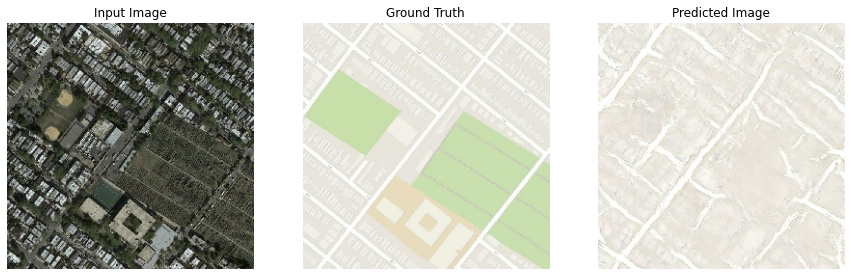

Time taken for epoch 40 is 88.78600263595581 sec

Epoch:  41
  loss (g) (d) (g+d):     10.722, 0.457, 11.180
Time taken for epoch 41 is 88.39743638038635 sec

Epoch:  42
  loss (g) (d) (g+d):     10.497, 0.512, 11.009
Time taken for epoch 42 is 88.40544724464417 sec

Epoch:  43
  loss (g) (d) (g+d):     10.671, 0.475, 11.146
Time taken for epoch 43 is 88.09552597999573 sec

Epoch:  44
  loss (g) (d) (g+d):     10.753, 0.503, 11.256
Time taken for epoch 44 is 88.36072039604187 sec

Epoch:  45
  loss (g) (d) (g+d):     10.672, 0.433, 11.106


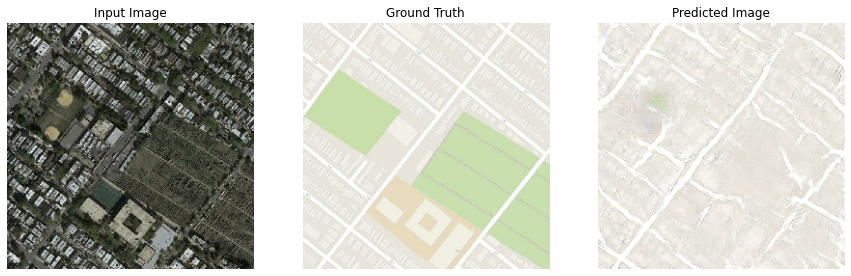

Time taken for epoch 45 is 88.55885028839111 sec

Epoch:  46
  loss (g) (d) (g+d):     10.494, 0.568, 11.062
Time taken for epoch 46 is 88.63091564178467 sec

Epoch:  47
  loss (g) (d) (g+d):     10.636, 0.473, 11.109
Time taken for epoch 47 is 88.60317826271057 sec

Epoch:  48
  loss (g) (d) (g+d):     10.563, 0.434, 10.997
Time taken for epoch 48 is 88.20630407333374 sec

Epoch:  49
  loss (g) (d) (g+d):     10.592, 0.517, 11.109
Time taken for epoch 49 is 88.35434579849243 sec

Epoch:  50
  loss (g) (d) (g+d):     10.586, 0.484, 11.070


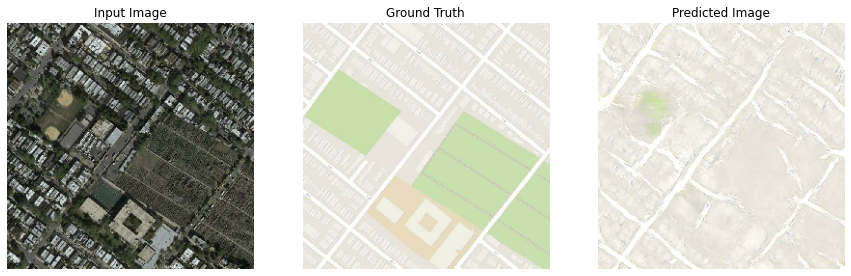

Time taken for epoch 50 is 88.53739094734192 sec

Epoch:  51
  loss (g) (d) (g+d):     10.468, 0.486, 10.954
Time taken for epoch 51 is 88.66754341125488 sec

Epoch:  52
  loss (g) (d) (g+d):     10.577, 0.446, 11.023
Time taken for epoch 52 is 88.39768719673157 sec

Epoch:  53
  loss (g) (d) (g+d):     10.776, 0.400, 11.176
Time taken for epoch 53 is 89.10161828994751 sec

Epoch:  54
  loss (g) (d) (g+d):     10.524, 0.530, 11.054
Time taken for epoch 54 is 88.75091862678528 sec

Epoch:  55
  loss (g) (d) (g+d):     10.604, 0.472, 11.076


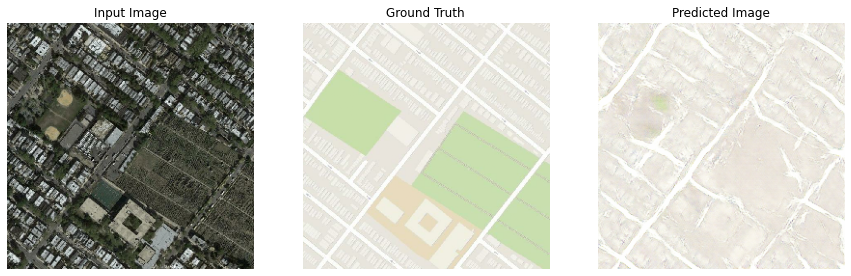

Time taken for epoch 55 is 88.83484649658203 sec

Epoch:  56
  loss (g) (d) (g+d):     10.656, 0.430, 11.086
Time taken for epoch 56 is 88.85578870773315 sec

Epoch:  57
  loss (g) (d) (g+d):     10.615, 0.434, 11.049
Time taken for epoch 57 is 89.01543426513672 sec

Epoch:  58
  loss (g) (d) (g+d):     10.543, 0.445, 10.988
Time taken for epoch 58 is 89.69925928115845 sec

Epoch:  59
  loss (g) (d) (g+d):     10.648, 0.455, 11.103
Time taken for epoch 59 is 90.31918001174927 sec

Epoch:  60
  loss (g) (d) (g+d):     10.673, 0.402, 11.075


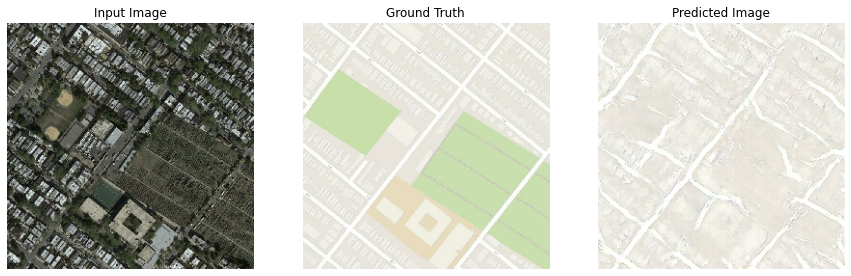

Time taken for epoch 60 is 89.64595222473145 sec

Epoch:  61
  loss (g) (d) (g+d):     10.531, 0.465, 10.996
Time taken for epoch 61 is 89.37295651435852 sec

Epoch:  62
  loss (g) (d) (g+d):     10.757, 0.395, 11.152
Time taken for epoch 62 is 89.11264991760254 sec

Epoch:  63
  loss (g) (d) (g+d):     10.494, 0.497, 10.991
Time taken for epoch 63 is 89.00588130950928 sec

Epoch:  64
  loss (g) (d) (g+d):     10.678, 0.395, 11.073
Time taken for epoch 64 is 89.22744345664978 sec

Epoch:  65
  loss (g) (d) (g+d):     10.608, 0.465, 11.073


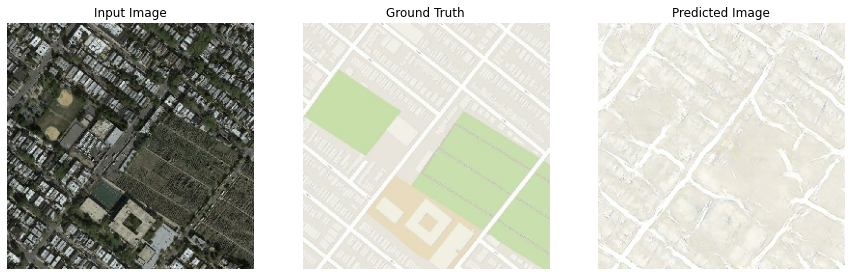

Time taken for epoch 65 is 89.43230199813843 sec

Epoch:  66
  loss (g) (d) (g+d):     10.615, 0.453, 11.069
Time taken for epoch 66 is 89.69057631492615 sec

Epoch:  67
  loss (g) (d) (g+d):     10.453, 0.451, 10.903
Time taken for epoch 67 is 88.63343405723572 sec

Epoch:  68
  loss (g) (d) (g+d):     10.646, 0.437, 11.083
Time taken for epoch 68 is 89.02995586395264 sec

Epoch:  69
  loss (g) (d) (g+d):     10.594, 0.481, 11.075
Time taken for epoch 69 is 88.54136967658997 sec

Epoch:  70
  loss (g) (d) (g+d):     10.409, 0.421, 10.830


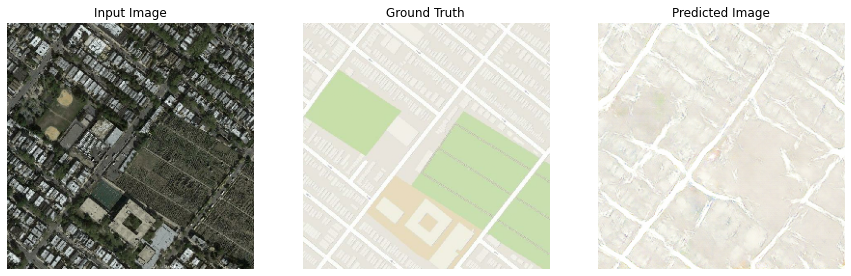

Time taken for epoch 70 is 89.52459263801575 sec

Epoch:  71
  loss (g) (d) (g+d):     10.606, 0.381, 10.986
Time taken for epoch 71 is 89.00201964378357 sec

Epoch:  72
  loss (g) (d) (g+d):     10.567, 0.444, 11.011
Time taken for epoch 72 is 89.34220433235168 sec

Epoch:  73
  loss (g) (d) (g+d):     10.484, 0.537, 11.021
Time taken for epoch 73 is 89.21932983398438 sec

Epoch:  74
  loss (g) (d) (g+d):     10.563, 0.369, 10.932
Time taken for epoch 74 is 89.64687943458557 sec

Epoch:  75
  loss (g) (d) (g+d):     10.495, 0.447, 10.942


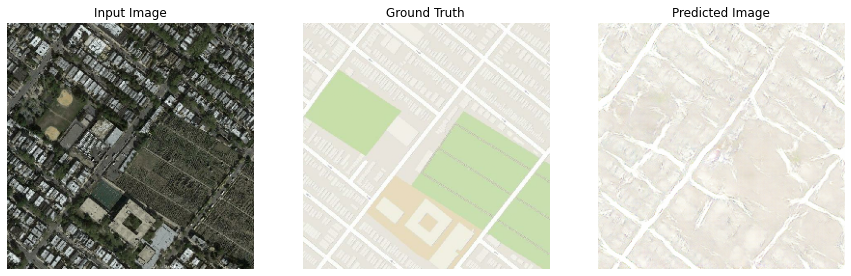

Time taken for epoch 75 is 89.96999311447144 sec

Epoch:  76
  loss (g) (d) (g+d):     10.514, 0.402, 10.916
Time taken for epoch 76 is 88.9404444694519 sec

Epoch:  77
  loss (g) (d) (g+d):     10.578, 0.473, 11.051
Time taken for epoch 77 is 88.50184774398804 sec

Epoch:  78
  loss (g) (d) (g+d):     10.279, 0.474, 10.752
Time taken for epoch 78 is 88.4748387336731 sec

Epoch:  79
  loss (g) (d) (g+d):     10.641, 0.396, 11.037
Time taken for epoch 79 is 89.89581823348999 sec

Epoch:  80
  loss (g) (d) (g+d):     10.321, 0.514, 10.834


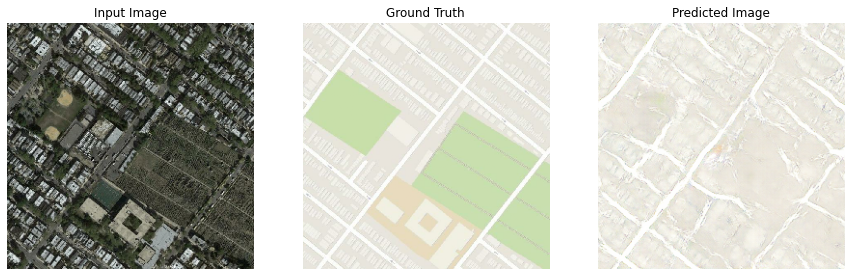

Time taken for epoch 80 is 88.80188012123108 sec

Epoch:  81
  loss (g) (d) (g+d):     10.439, 0.360, 10.800
Time taken for epoch 81 is 88.74040913581848 sec

Epoch:  82
  loss (g) (d) (g+d):     10.548, 0.417, 10.965
Time taken for epoch 82 is 89.01975154876709 sec

Epoch:  83
  loss (g) (d) (g+d):     10.487, 0.426, 10.913
Time taken for epoch 83 is 88.87259268760681 sec

Epoch:  84
  loss (g) (d) (g+d):     10.202, 0.471, 10.673
Time taken for epoch 84 is 88.49122095108032 sec

Epoch:  85
  loss (g) (d) (g+d):     10.482, 0.413, 10.895


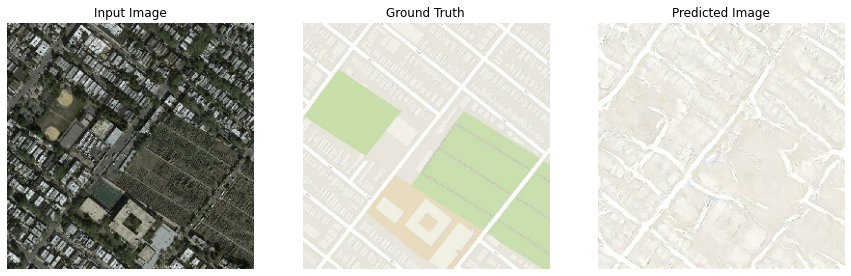

Time taken for epoch 85 is 88.88465452194214 sec

Epoch:  86
  loss (g) (d) (g+d):     10.588, 0.387, 10.975
Time taken for epoch 86 is 88.96623086929321 sec

Epoch:  87
  loss (g) (d) (g+d):     10.452, 0.489, 10.941
Time taken for epoch 87 is 88.6629285812378 sec

Epoch:  88
  loss (g) (d) (g+d):     10.537, 0.410, 10.947
Time taken for epoch 88 is 88.56812167167664 sec

Epoch:  89
  loss (g) (d) (g+d):     10.397, 0.401, 10.798
Time taken for epoch 89 is 88.88485431671143 sec

Epoch:  90
  loss (g) (d) (g+d):     10.164, 0.500, 10.664


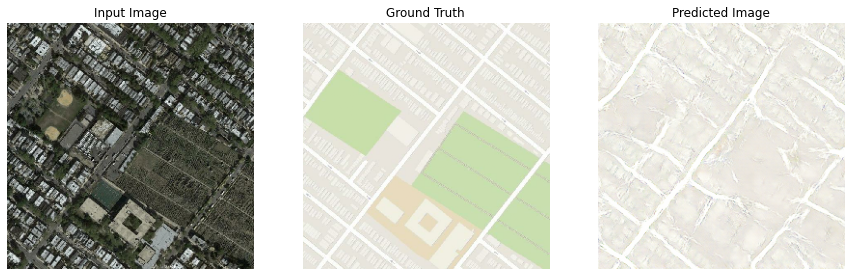

Time taken for epoch 90 is 88.9699444770813 sec

Epoch:  91
  loss (g) (d) (g+d):     10.313, 0.469, 10.782
Time taken for epoch 91 is 88.5761079788208 sec

Epoch:  92
  loss (g) (d) (g+d):     10.688, 0.291, 10.979
Time taken for epoch 92 is 88.51947832107544 sec

Epoch:  93
  loss (g) (d) (g+d):     10.348, 0.438, 10.786
Time taken for epoch 93 is 89.24883604049683 sec

Epoch:  94
  loss (g) (d) (g+d):     10.325, 0.480, 10.805
Time taken for epoch 94 is 88.63108277320862 sec

Epoch:  95
  loss (g) (d) (g+d):     10.334, 0.458, 10.792


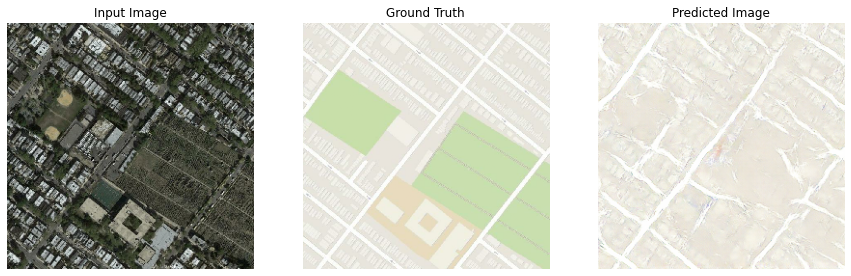

Time taken for epoch 95 is 88.80207824707031 sec

Epoch:  96
  loss (g) (d) (g+d):     10.542, 0.319, 10.861
Time taken for epoch 96 is 89.11008620262146 sec

Epoch:  97
  loss (g) (d) (g+d):     10.299, 0.482, 10.781
Time taken for epoch 97 is 89.41973686218262 sec

Epoch:  98
  loss (g) (d) (g+d):     10.353, 0.430, 10.783
Time taken for epoch 98 is 88.9423840045929 sec

Epoch:  99
  loss (g) (d) (g+d):     10.425, 0.370, 10.795
Time taken for epoch 99 is 90.28791618347168 sec

Epoch:  100
  loss (g) (d) (g+d):     10.293, 0.458, 10.751


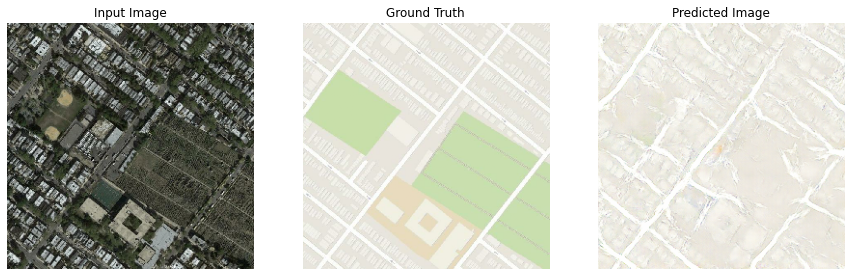

Time taken for epoch 100 is 89.9124493598938 sec

Epoch:  101
  loss (g) (d) (g+d):     10.532, 0.351, 10.883
Time taken for epoch 101 is 88.9061176776886 sec

Epoch:  102
  loss (g) (d) (g+d):     10.404, 0.534, 10.938
Time taken for epoch 102 is 88.84156584739685 sec

Epoch:  103
  loss (g) (d) (g+d):     10.387, 0.374, 10.761
Time taken for epoch 103 is 88.47267937660217 sec

Epoch:  104
  loss (g) (d) (g+d):     10.657, 0.377, 11.033
Time taken for epoch 104 is 88.73169684410095 sec

Epoch:  105
  loss (g) (d) (g+d):     10.398, 0.423, 10.821


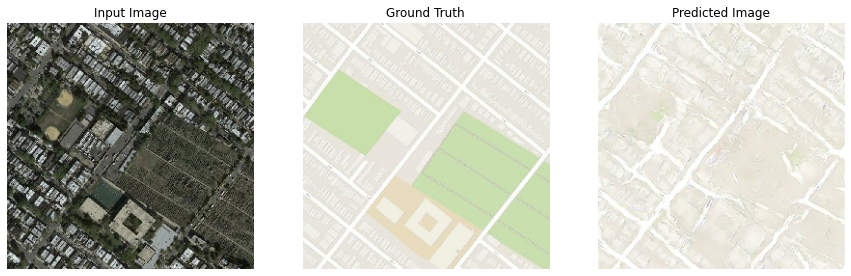

Time taken for epoch 105 is 88.44096946716309 sec

Epoch:  106
  loss (g) (d) (g+d):     10.178, 0.454, 10.632
Time taken for epoch 106 is 88.33008790016174 sec

Epoch:  107
  loss (g) (d) (g+d):     10.488, 0.352, 10.840
Time taken for epoch 107 is 89.28634667396545 sec

Epoch:  108
  loss (g) (d) (g+d):     10.252, 0.495, 10.747
Time taken for epoch 108 is 88.35301113128662 sec

Epoch:  109
  loss (g) (d) (g+d):     10.555, 0.339, 10.895
Time taken for epoch 109 is 88.30482792854309 sec

Epoch:  110
  loss (g) (d) (g+d):     10.276, 0.454, 10.730


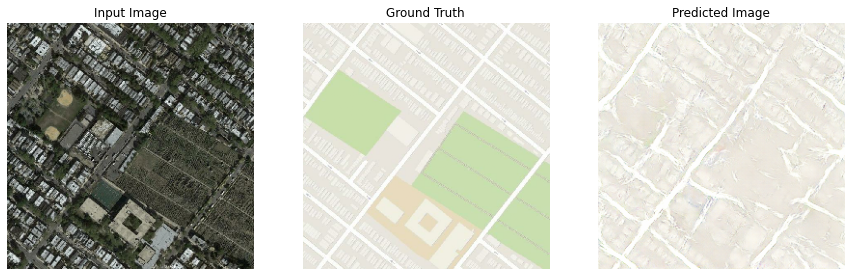

Time taken for epoch 110 is 88.72554659843445 sec

Epoch:  111
  loss (g) (d) (g+d):     10.525, 0.373, 10.898
Time taken for epoch 111 is 88.48066067695618 sec

Epoch:  112
  loss (g) (d) (g+d):     10.580, 0.478, 11.059
Time taken for epoch 112 is 88.29295659065247 sec

Epoch:  113
  loss (g) (d) (g+d):     10.314, 0.405, 10.719
Time taken for epoch 113 is 88.32637119293213 sec

Epoch:  114
  loss (g) (d) (g+d):     10.304, 0.380, 10.683
Time taken for epoch 114 is 88.61883425712585 sec

Epoch:  115
  loss (g) (d) (g+d):     10.380, 0.457, 10.837


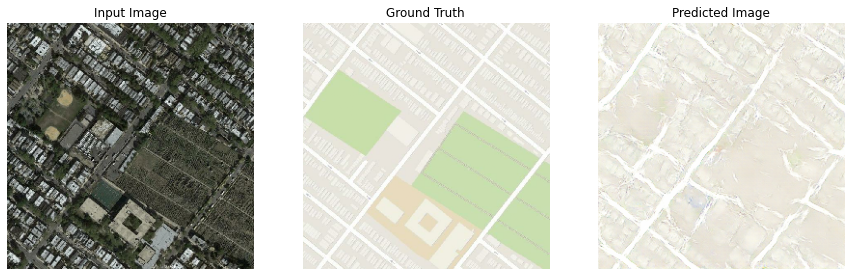

Time taken for epoch 115 is 88.956387758255 sec

Epoch:  116
  loss (g) (d) (g+d):     10.409, 0.377, 10.786
Time taken for epoch 116 is 88.53053188323975 sec

Epoch:  117
  loss (g) (d) (g+d):     10.153, 0.492, 10.645
Time taken for epoch 117 is 88.60113596916199 sec

Epoch:  118
  loss (g) (d) (g+d):     10.336, 0.372, 10.708
Time taken for epoch 118 is 88.310879945755 sec

Epoch:  119
  loss (g) (d) (g+d):     10.282, 0.429, 10.711
Time taken for epoch 119 is 89.61889839172363 sec

Epoch:  120
  loss (g) (d) (g+d):     10.411, 0.431, 10.841


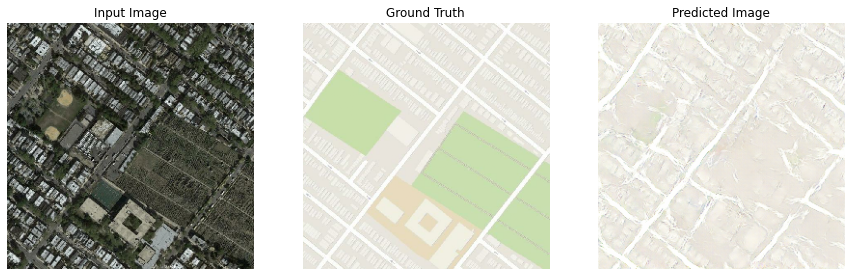

Time taken for epoch 120 is 88.63802862167358 sec

Epoch:  121
  loss (g) (d) (g+d):     10.351, 0.338, 10.689
Time taken for epoch 121 is 88.70007514953613 sec

Epoch:  122
  loss (g) (d) (g+d):     10.338, 0.451, 10.789
Time taken for epoch 122 is 88.33067655563354 sec

Epoch:  123
  loss (g) (d) (g+d):     10.468, 0.351, 10.819
Time taken for epoch 123 is 88.27654361724854 sec

Epoch:  124
  loss (g) (d) (g+d):     10.291, 0.515, 10.805
Time taken for epoch 124 is 88.66371893882751 sec

Epoch:  125
  loss (g) (d) (g+d):     10.465, 0.333, 10.797


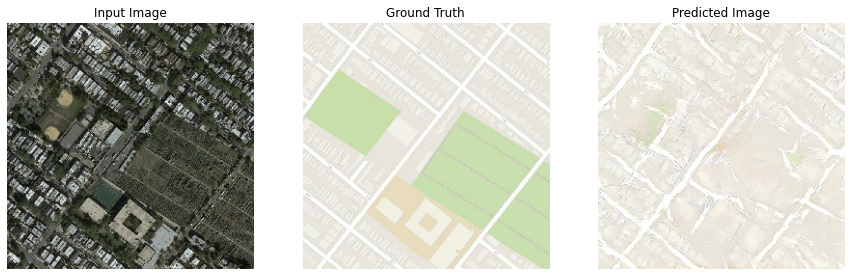

Time taken for epoch 125 is 88.52887105941772 sec

Epoch:  126
  loss (g) (d) (g+d):     10.392, 0.473, 10.865
Time taken for epoch 126 is 88.49735450744629 sec

Epoch:  127
  loss (g) (d) (g+d):     10.487, 0.351, 10.838
Time taken for epoch 127 is 88.330078125 sec

Epoch:  128
  loss (g) (d) (g+d):     10.192, 0.440, 10.632
Time taken for epoch 128 is 88.62490153312683 sec

Epoch:  129
  loss (g) (d) (g+d):     10.163, 0.501, 10.664
Time taken for epoch 129 is 88.18133234977722 sec

Epoch:  130
  loss (g) (d) (g+d):     10.510, 0.329, 10.838


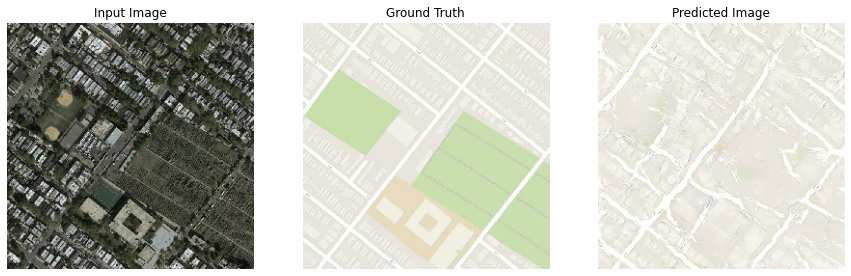

Time taken for epoch 130 is 88.46246433258057 sec

Epoch:  131
  loss (g) (d) (g+d):     10.218, 0.477, 10.694
Time taken for epoch 131 is 88.74430561065674 sec

Epoch:  132
  loss (g) (d) (g+d):     10.264, 0.390, 10.654
Time taken for epoch 132 is 88.21473598480225 sec

Epoch:  133
  loss (g) (d) (g+d):     10.411, 0.390, 10.801
Time taken for epoch 133 is 88.39388537406921 sec

Epoch:  134
  loss (g) (d) (g+d):     10.507, 0.343, 10.850
Time taken for epoch 134 is 88.26065564155579 sec

Epoch:  135
  loss (g) (d) (g+d):     10.223, 0.451, 10.675


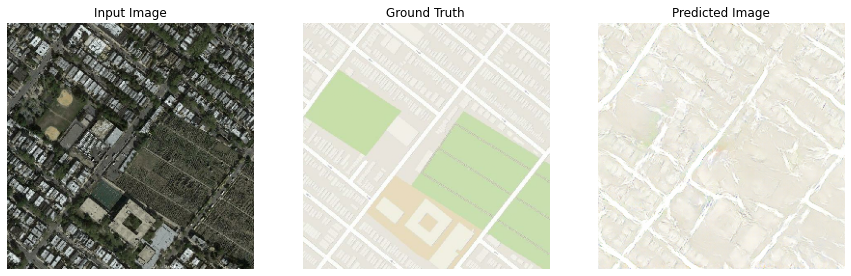

Time taken for epoch 135 is 88.83664560317993 sec

Epoch:  136
  loss (g) (d) (g+d):     10.226, 0.489, 10.716
Time taken for epoch 136 is 88.76685380935669 sec

Epoch:  137
  loss (g) (d) (g+d):     10.454, 0.342, 10.796
Time taken for epoch 137 is 88.75943326950073 sec

Epoch:  138
  loss (g) (d) (g+d):     10.300, 0.444, 10.744
Time taken for epoch 138 is 88.94858837127686 sec

Epoch:  139
  loss (g) (d) (g+d):     10.155, 0.415, 10.571
Time taken for epoch 139 is 89.8568046092987 sec

Epoch:  140
  loss (g) (d) (g+d):     10.328, 0.454, 10.782


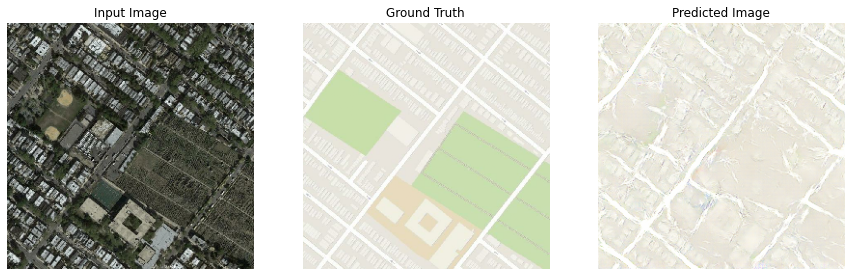

Time taken for epoch 140 is 89.41354084014893 sec

Epoch:  141
  loss (g) (d) (g+d):     10.296, 0.370, 10.667
Time taken for epoch 141 is 90.15641641616821 sec

Epoch:  142
  loss (g) (d) (g+d):     10.307, 0.383, 10.689
Time taken for epoch 142 is 89.32898092269897 sec

Epoch:  143
  loss (g) (d) (g+d):     10.361, 0.388, 10.748
Time taken for epoch 143 is 89.36728262901306 sec

Epoch:  144
  loss (g) (d) (g+d):     10.327, 0.409, 10.736
Time taken for epoch 144 is 88.44009566307068 sec

Epoch:  145
  loss (g) (d) (g+d):     10.193, 0.466, 10.659


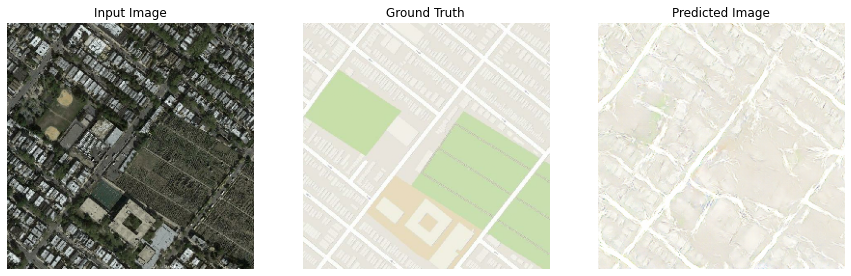

Time taken for epoch 145 is 89.28292894363403 sec

Epoch:  146
  loss (g) (d) (g+d):     10.357, 0.375, 10.732
Time taken for epoch 146 is 88.56278562545776 sec

Epoch:  147
  loss (g) (d) (g+d):     10.465, 0.382, 10.847
Time taken for epoch 147 is 88.53718376159668 sec

Epoch:  148
  loss (g) (d) (g+d):     10.368, 0.397, 10.765
Time taken for epoch 148 is 89.56416940689087 sec

Epoch:  149
  loss (g) (d) (g+d):     10.275, 0.393, 10.668
Time taken for epoch 149 is 90.54064226150513 sec

Epoch:  150
  loss (g) (d) (g+d):     10.192, 0.465, 10.657


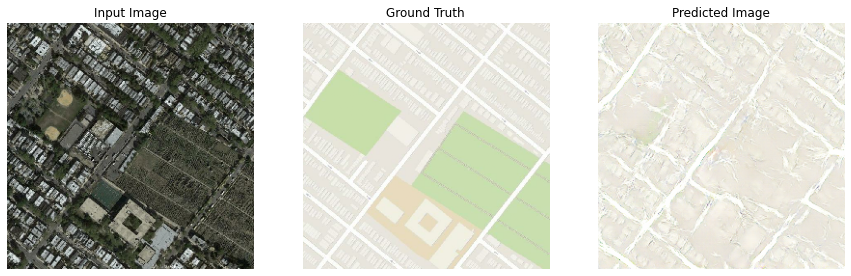

Time taken for epoch 150 is 91.68350863456726 sec

Epoch:  151
  loss (g) (d) (g+d):     10.278, 0.450, 10.728
Time taken for epoch 151 is 92.10080003738403 sec

Epoch:  152
  loss (g) (d) (g+d):     10.241, 0.417, 10.658
Time taken for epoch 152 is 91.28999090194702 sec

Epoch:  153
  loss (g) (d) (g+d):     10.391, 0.442, 10.833
Time taken for epoch 153 is 89.04961681365967 sec

Epoch:  154
  loss (g) (d) (g+d):     10.243, 0.400, 10.643
Time taken for epoch 154 is 89.42676544189453 sec

Epoch:  155
  loss (g) (d) (g+d):     10.257, 0.392, 10.649


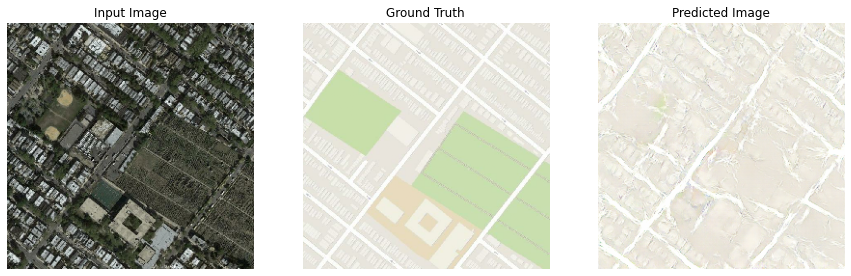

Time taken for epoch 155 is 89.72670078277588 sec

Epoch:  156
  loss (g) (d) (g+d):     10.136, 0.391, 10.527
Time taken for epoch 156 is 89.09321737289429 sec

Epoch:  157
  loss (g) (d) (g+d):     10.440, 0.359, 10.799
Time taken for epoch 157 is 88.50893568992615 sec

Epoch:  158
  loss (g) (d) (g+d):     10.118, 0.466, 10.585
Time taken for epoch 158 is 88.78784251213074 sec

Epoch:  159
  loss (g) (d) (g+d):     10.433, 0.457, 10.890
Time taken for epoch 159 is 89.84992408752441 sec

Epoch:  160
  loss (g) (d) (g+d):     10.187, 0.388, 10.575


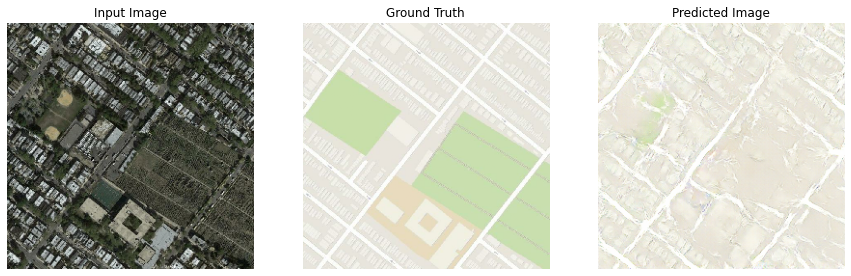

Time taken for epoch 160 is 89.19959926605225 sec

Epoch:  161
  loss (g) (d) (g+d):     10.463, 0.425, 10.888
Time taken for epoch 161 is 88.81498050689697 sec

Epoch:  162
  loss (g) (d) (g+d):     10.120, 0.432, 10.552
Time taken for epoch 162 is 88.9508843421936 sec

Epoch:  163
  loss (g) (d) (g+d):     10.163, 0.398, 10.560
Time taken for epoch 163 is 88.86143636703491 sec

Epoch:  164
  loss (g) (d) (g+d):     10.303, 0.350, 10.653
Time taken for epoch 164 is 88.51716113090515 sec

Epoch:  165
  loss (g) (d) (g+d):     10.239, 0.422, 10.661


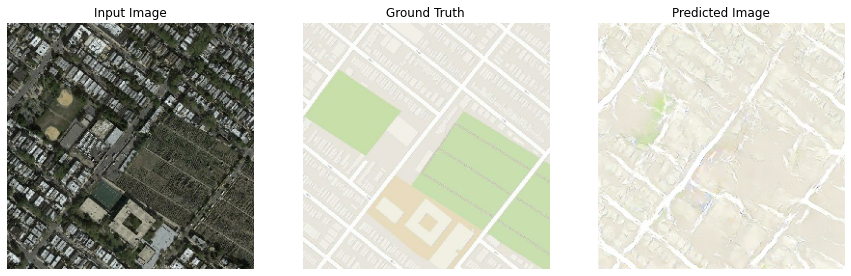

Time taken for epoch 165 is 88.77111482620239 sec

Epoch:  166
  loss (g) (d) (g+d):     10.034, 0.470, 10.504
Time taken for epoch 166 is 88.82676434516907 sec

Epoch:  167
  loss (g) (d) (g+d):     10.376, 0.330, 10.705
Time taken for epoch 167 is 88.58099365234375 sec

Epoch:  168
  loss (g) (d) (g+d):     10.249, 0.492, 10.741
Time taken for epoch 168 is 88.42307949066162 sec

Epoch:  169
  loss (g) (d) (g+d):     9.994, 0.429, 10.424
Time taken for epoch 169 is 88.58786106109619 sec

Epoch:  170
  loss (g) (d) (g+d):     10.045, 0.484, 10.529


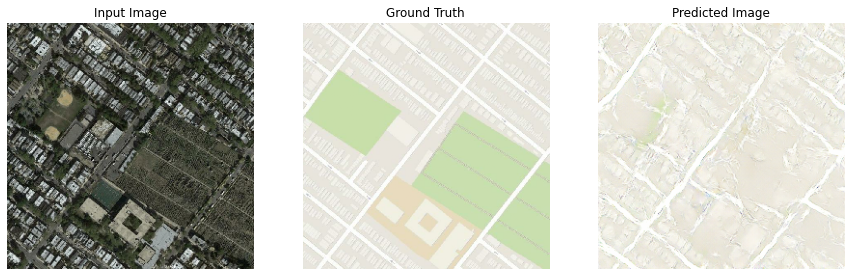

Time taken for epoch 170 is 88.91418361663818 sec

Epoch:  171
  loss (g) (d) (g+d):     10.240, 0.344, 10.585
Time taken for epoch 171 is 88.7304298877716 sec

Epoch:  172
  loss (g) (d) (g+d):     10.252, 0.411, 10.662
Time taken for epoch 172 is 88.49306416511536 sec

Epoch:  173
  loss (g) (d) (g+d):     10.292, 0.368, 10.660
Time taken for epoch 173 is 89.42982959747314 sec

Epoch:  174
  loss (g) (d) (g+d):     10.251, 0.397, 10.648
Time taken for epoch 174 is 88.34134984016418 sec

Epoch:  175
  loss (g) (d) (g+d):     10.190, 0.446, 10.636


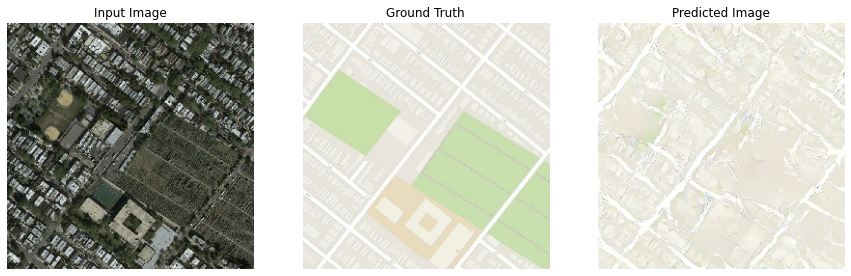

Time taken for epoch 175 is 88.94104814529419 sec

Epoch:  176
  loss (g) (d) (g+d):     10.142, 0.450, 10.592
Time taken for epoch 176 is 89.19338917732239 sec

Epoch:  177
  loss (g) (d) (g+d):     10.356, 0.397, 10.754
Time taken for epoch 177 is 89.25807619094849 sec

Epoch:  178
  loss (g) (d) (g+d):     10.345, 0.395, 10.740
Time taken for epoch 178 is 89.2201042175293 sec

Epoch:  179
  loss (g) (d) (g+d):     10.187, 0.395, 10.582
Time taken for epoch 179 is 91.44369530677795 sec

Epoch:  180
  loss (g) (d) (g+d):     10.299, 0.387, 10.686


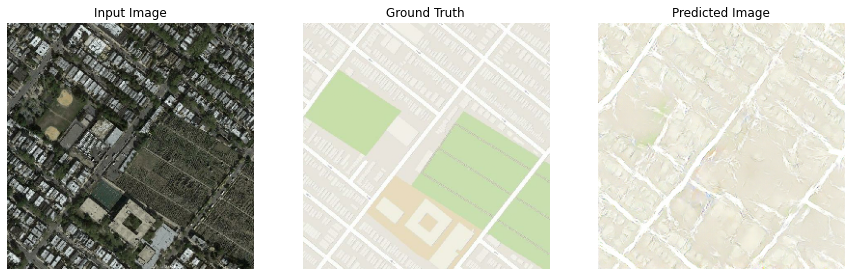

Time taken for epoch 180 is 89.89525747299194 sec

Epoch:  181
  loss (g) (d) (g+d):     10.058, 0.463, 10.521
Time taken for epoch 181 is 89.22289824485779 sec

Epoch:  182
  loss (g) (d) (g+d):     10.088, 0.414, 10.501
Time taken for epoch 182 is 92.57594156265259 sec

Epoch:  183
  loss (g) (d) (g+d):     10.295, 0.391, 10.686
Time taken for epoch 183 is 89.58795213699341 sec

Epoch:  184
  loss (g) (d) (g+d):     9.981, 0.537, 10.518
Time taken for epoch 184 is 88.96079325675964 sec

Epoch:  185
  loss (g) (d) (g+d):     10.175, 0.370, 10.545


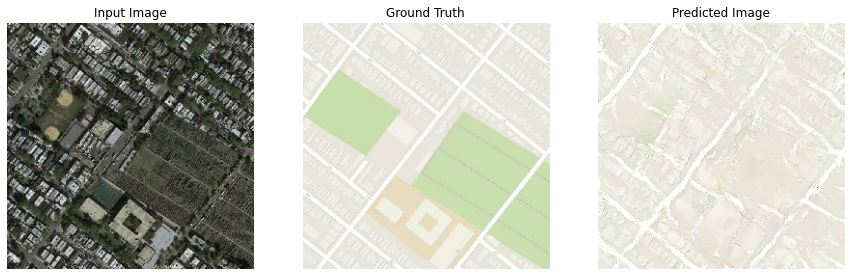

Time taken for epoch 185 is 88.86200499534607 sec

Epoch:  186
  loss (g) (d) (g+d):     10.133, 0.400, 10.533
Time taken for epoch 186 is 90.12030458450317 sec

Epoch:  187
  loss (g) (d) (g+d):     9.955, 0.458, 10.413
Time taken for epoch 187 is 89.62196135520935 sec

Epoch:  188
  loss (g) (d) (g+d):     10.247, 0.349, 10.597
Time taken for epoch 188 is 89.75256109237671 sec

Epoch:  189
  loss (g) (d) (g+d):     10.379, 0.391, 10.770
Time taken for epoch 189 is 90.41958856582642 sec

Epoch:  190
  loss (g) (d) (g+d):     10.161, 0.446, 10.607


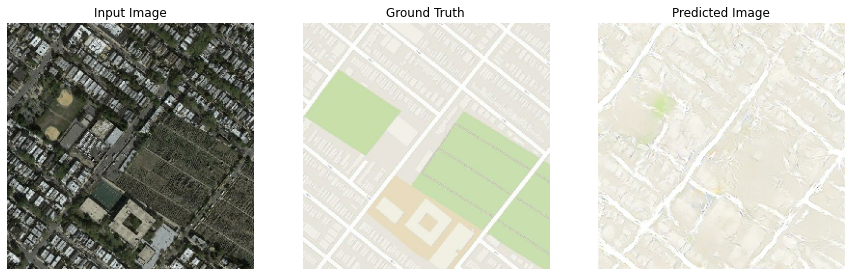

Time taken for epoch 190 is 91.3261411190033 sec

Epoch:  191
  loss (g) (d) (g+d):     10.071, 0.426, 10.496
Time taken for epoch 191 is 91.03822565078735 sec

Epoch:  192
  loss (g) (d) (g+d):     10.290, 0.394, 10.684
Time taken for epoch 192 is 91.03602576255798 sec

Epoch:  193
  loss (g) (d) (g+d):     10.175, 0.376, 10.551
Time taken for epoch 193 is 90.77916264533997 sec

Epoch:  194
  loss (g) (d) (g+d):     10.094, 0.424, 10.518
Time taken for epoch 194 is 90.4595856666565 sec

Epoch:  195
  loss (g) (d) (g+d):     10.405, 0.357, 10.761


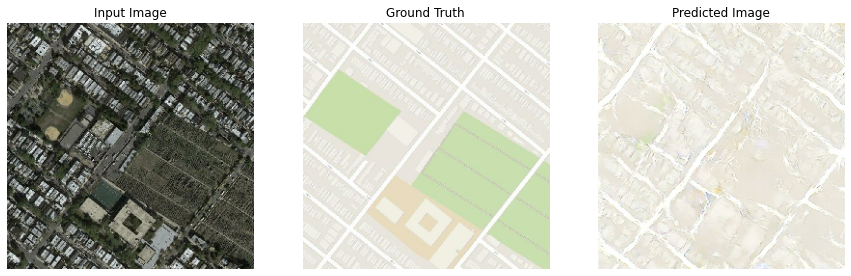

Time taken for epoch 195 is 90.81625318527222 sec

Epoch:  196
  loss (g) (d) (g+d):     10.025, 0.465, 10.489
Time taken for epoch 196 is 90.28156018257141 sec

Epoch:  197
  loss (g) (d) (g+d):     10.092, 0.416, 10.508
Time taken for epoch 197 is 91.5699074268341 sec

Epoch:  198
  loss (g) (d) (g+d):     10.320, 0.359, 10.679
Time taken for epoch 198 is 91.17570161819458 sec

Epoch:  199
  loss (g) (d) (g+d):     10.346, 0.407, 10.754
Time taken for epoch 199 is 93.11467695236206 sec



In [ ]:
epochs=200
g_loss_log = []
d_loss_log = []
g_loss_metric = tf.keras.metrics.Mean(name='g_train_loss')
d_loss_metric = tf.keras.metrics.Mean(name='d_train_loss')

for epoch in range(epochs):
  start = time.time()
  # Reset the metrics
  g_loss_metric.reset_states()
  d_loss_metric.reset_states()

  for input_image, target in train_dataset:
    train_step(input_image, target, g_loss_metric, d_loss_metric)

  # Get the metric results
  g_mean_loss = g_loss_metric.result()
  d_mean_loss = d_loss_metric.result()
  g_loss_log.append([g_mean_loss])
  d_loss_log.append([d_mean_loss])

  print('Epoch: ', epoch)
  print('  loss (g) (d) (g+d):     {:.3f}, {:.3f}, {:.3f}'.format(g_mean_loss, d_mean_loss, g_mean_loss + d_mean_loss))
  #displaying an image on the testing data set for rvery 5 epochs
  if epoch%5==0:
    generate_images(generator, inp, tar,epoch)
  

  # saving (checkpoint) the model every 20 epochs
  if (epoch + 1) % 20 == 0:
    checkpoint.save(file_prefix = checkpoint_prefix)
  print('Time taken for epoch {} is {} sec\n'.format(epoch,time.time()-start))

In [ ]:
def plot_loss(g_loss, d_loss,type_='generator'):
    """Plot the losses each epoc during training."""
    total_loss = [g[0].numpy() + d[0].numpy() for g, d in zip(g_loss, d_loss)]
    g_loss = [g[0].numpy() for g in g_loss]
    d_loss = [d[0].numpy() for d in d_loss]
    plt.figure(figsize=(10,5))
    plt.plot(g_loss, label=type_+' generator loss')
    plt.plot(d_loss, label=type_+' discriminator loss')
    plt.plot(total_loss, label='total loss')
    plt.legend()
    plt.xlabel('epoch')
    plt.ylabel('loss')
    plt.title('training loss')

**Generative and Discriminator loss for training**

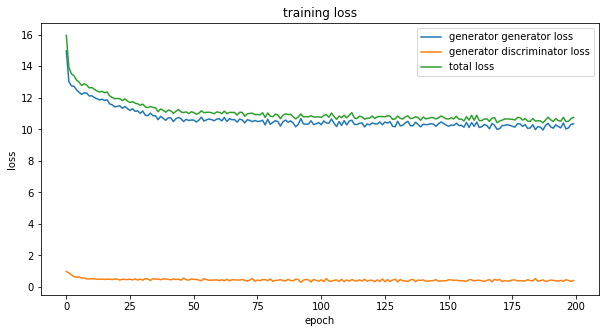

In [ ]:
plot_loss(g_loss_log, d_loss_log,'generator')

testing dataset evaluation

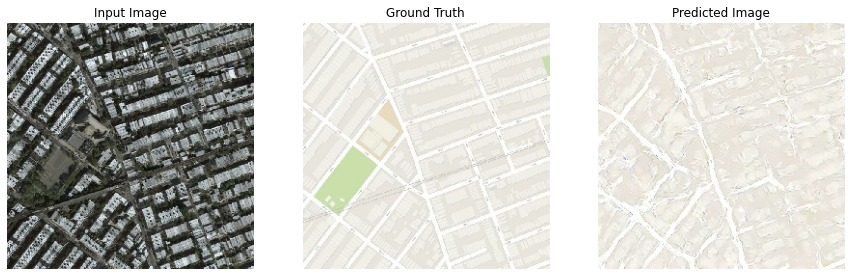

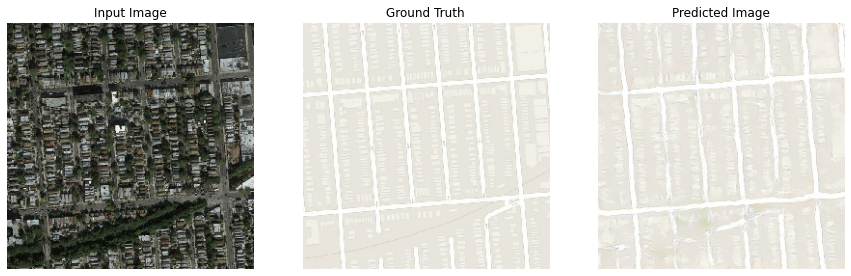

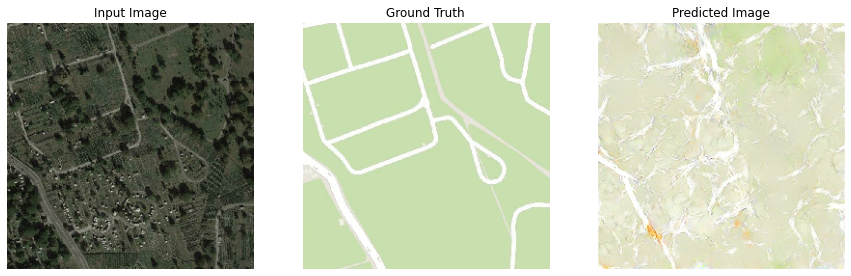

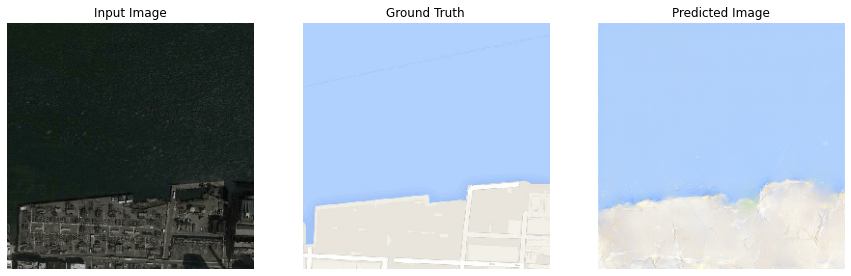

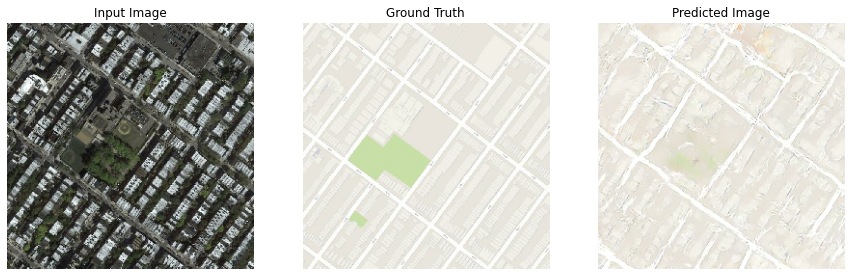

In [ ]:
# Run the trained model on a few examples from the test dataset
for inp, tar in test_dataset.take(5):
  generate_images(generator, inp, tar,1000,0)

**Evaluation the model by calculating MSE error**

In [ ]:
avg_mse = 0
it = 0
  
for input_image , target in test_dataset:
    it += 1
    gen_output = generator(input_image, training=True)
    avg_mse += tf.reduce_mean(tf.math.squared_difference(target, gen_output)).numpy() #mean square error for test dataset

avg_mse /= it
print(avg_mse)

0.01999850225175149


In [ ]:
print("MSE value is : {:.11f}".format(avg_mse))

MSE value is : 0.01999850225
